# Load the dataset

In [2]:
import tensorflow as tf
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, AgglomerativeClustering, SpectralClustering, DBSCAN
from scipy.stats import zscore
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from sklearn.metrics import silhouette_score
import tensorflow_datasets as tfds
from sklearn.metrics import calinski_harabasz_score
from scipy.sparse import csgraph
from scipy.linalg import eigh


# Load the dataset from TFDS (images only)
dataset = tfds.load("tf_flowers", split="train", as_supervised=False)
# Extract images from the dataset
images = []
for example in tfds.as_numpy(dataset):
    images.append(example["image"])  # Access the 'image' field directly
# Convert to numpy array and resize images
images = np.array([tf.image.resize(image, (224, 224)).numpy() for image in images])
# Preprocess images for MobileNetV2
processed_images = preprocess_input(images)
# Extract features using MobileNetV2
model = MobileNetV2(include_top=False, pooling="avg", input_shape=(224, 224, 3))
features = model.predict(processed_images, batch_size=32)
pd.DataFrame(features)

115/115 ━━━━━━━━━━━━━━━━━━━━ 105s 613ms/step


,0,1,2,3,4,5,6,7,8,9,...,1270,1271,1272,1273,1274,1275,1276,1277,1278,1279
0,1.115194,0.606122,0.000000,0.000000,1.093438,0.430245,0.612524,0.000000,0.714308,0.917207,...,1.752182,0.052995,0.924795,0.000000,2.434956,0.028501,0.791891,0.000000,0.000000,0.000000
1,0.030461,1.044023,0.000000,0.383247,0.000000,0.885311,0.064734,0.018397,0.020954,0.050749,...,0.124715,0.000000,0.812722,0.004023,2.295598,0.011484,0.009082,0.000000,1.235084,0.030962
2,0.000000,1.798329,0.000000,0.008548,0.000000,0.201093,0.093820,0.000000,0.148712,0.181639,...,0.000000,0.000000,0.860040,0.340574,1.924045,0.683361,0.239594,0.014125,0.000000,0.000000
3,0.233335,0.185569,0.000000,0.273293,0.000000,1.850524,0.629284,0.239058,0.733701,0.000000,...,0.249228,0.000000,0.140895,0.344289,0.248311,0.293356,2.463493,0.141531,0.834260,0.547097
4,0.000000,0.292305,0.000000,0.002798,0.000000,0.116715,0.019264,0.161185,0.000000,0.000000,...,0.489853,0.000000,2.182601,0.932733,2.507328,1.844067,0.000000,1.284348,0.089450,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3665,0.212487,0.762381,0.004465,0.000000,0.341231,1.556757,0.000000,1.838073,0.437147,0.000000,...,0.422149,0.059857,0.039440,0.318929,1.670318,0.475356,0.976639,0.035124,0.000000,2.379887
3666,0.155957,0.280238,0.027213,0.029858,0.564395,0.957505,2.195337,0.000000,0.344496,0.005945,...,1.441026,0.000000,0.342017,0.000000,0.075095,0.044798,0.111389,0.274762,0.031177,0.004446
3667,0.051377,2.772713,0.000000,0.000000,0.590756,0.724558,1.110111,0.000000,0.150957,1.609153,...,0.222322,0.000000,0.630335,0.609498,1.695732,0.081304,1.971174,0.000000,0.071366,0.192281
3668,0.000000,1.445232,0.070828,0.016929,0.000000,1.726258,0.000000,0.000000,0.419397,0.007217,...,0.000000,0.765940,0.002814,0.372877,0.348760,0.000000,0.000000,0.404012,0.000000,0.347080


# PCA and explained variance ratio

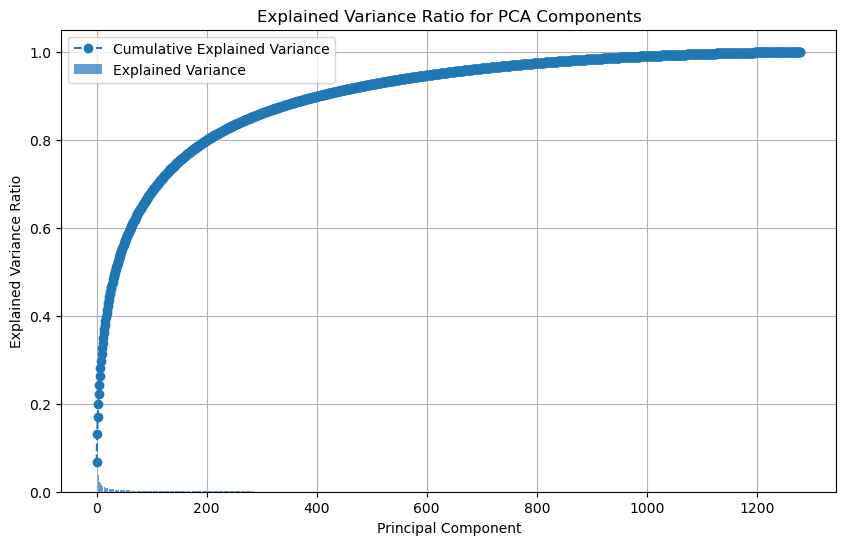

In [4]:
# Compute PCA and visualize the explained variance ratio
pca_full = PCA(n_components=features.shape[1])
pca_full.fit(features)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca_full.explained_variance_ratio_), marker='o', linestyle='--', label="Cumulative Explained Variance")
plt.bar(range(1, len(pca_full.explained_variance_ratio_) + 1), pca_full.explained_variance_ratio_, alpha=0.7, label="Explained Variance")
plt.xlabel("Principal Component")
plt.ylabel("Explained Variance Ratio")
plt.title("Explained Variance Ratio for PCA Components")
plt.legend()
plt.grid(True)
plt.show()
# Function to plot random images from each cluster
def plot_clusters(images, clusters, n_clusters=5, title="Clusters", seed=12):
    np.random.seed(seed)  # Set the seed for reproducibility
    fig, axes = plt.subplots(n_clusters, 5, figsize=(15, n_clusters * 3))
    fig.suptitle(title, fontsize=16)
    for cluster_idx in range(n_clusters):
        cluster_indices = np.where(clusters == cluster_idx)[0]
        if len(cluster_indices) > 0:
            selected_indices = np.random.choice(cluster_indices, min(5, len(cluster_indices)), replace=False)
            cluster_images = images[selected_indices]
            for i, ax in enumerate(axes[cluster_idx]):
                if i < len(cluster_images):
                    ax.imshow((cluster_images[i] + 1) / 2)  # Undo preprocessing normalization
                    ax.axis("off")
                else:
                    ax.axis("off")
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout for title
    plt.show()

# Clustering with PCA and outliers removal

Silhouette Score for K-Means: 0.08349519968032837
Silhouette Score for Spectral Clustering: 0.03726618364453316
Silhouette Score for Agglomerative Clustering: 0.02346133626997471
Calinski-Harabasz Index for K-Means: 116.9641504618403
Calinski-Harabasz Index for Spectral Clustering: 110.80417151071151
Calinski-Harabasz Index for Agglomerative Clustering: 108.71381869789072


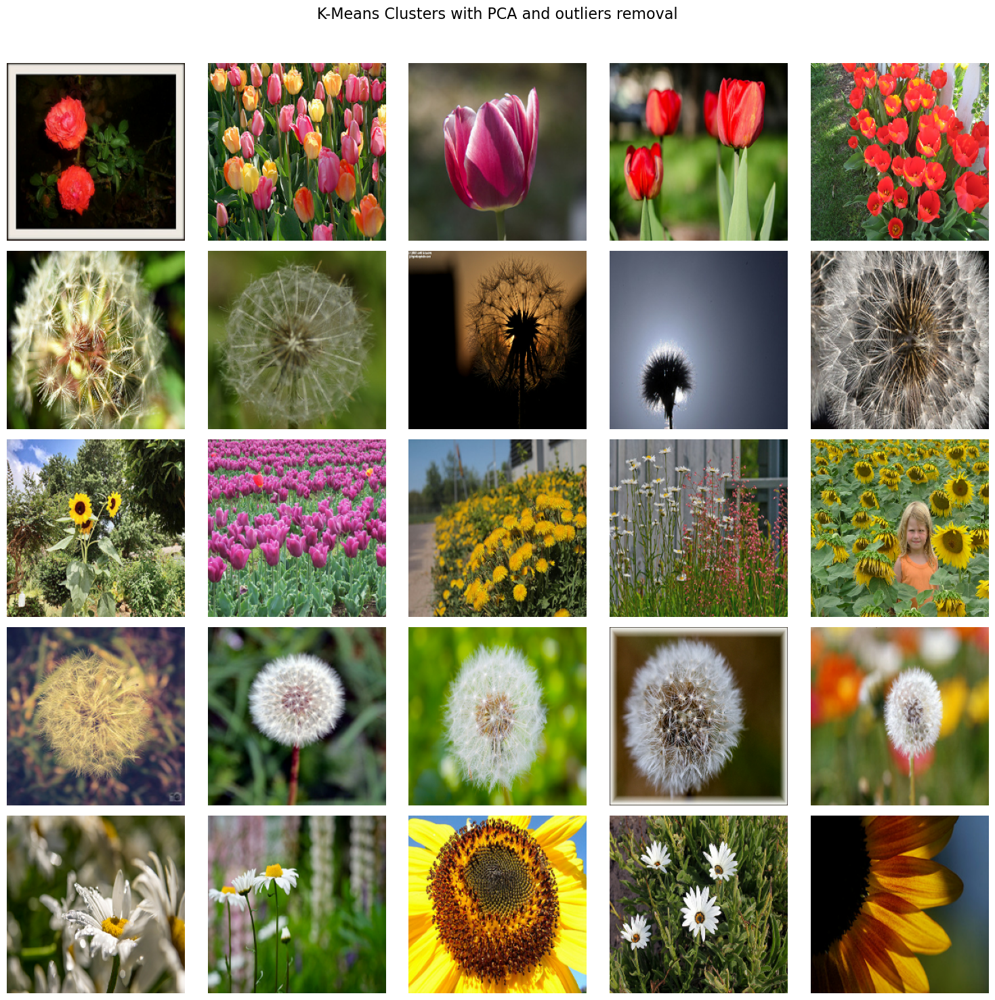

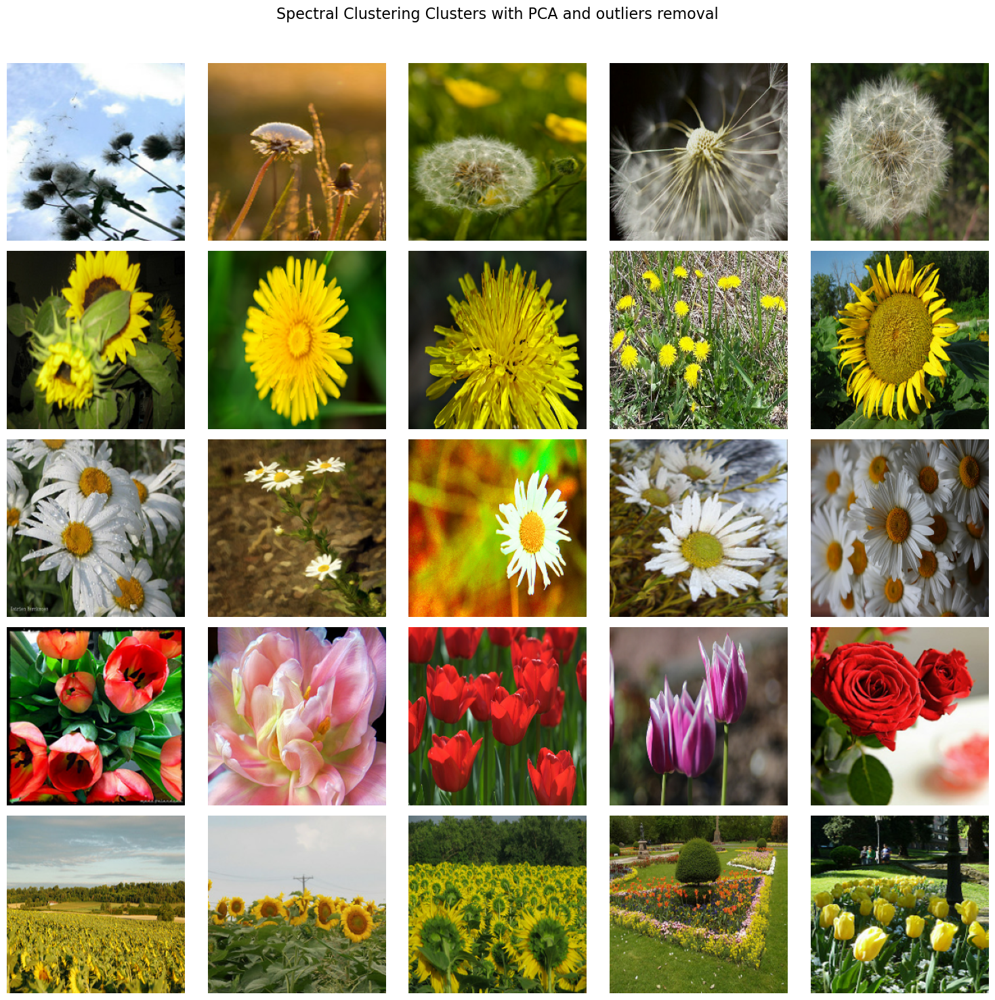

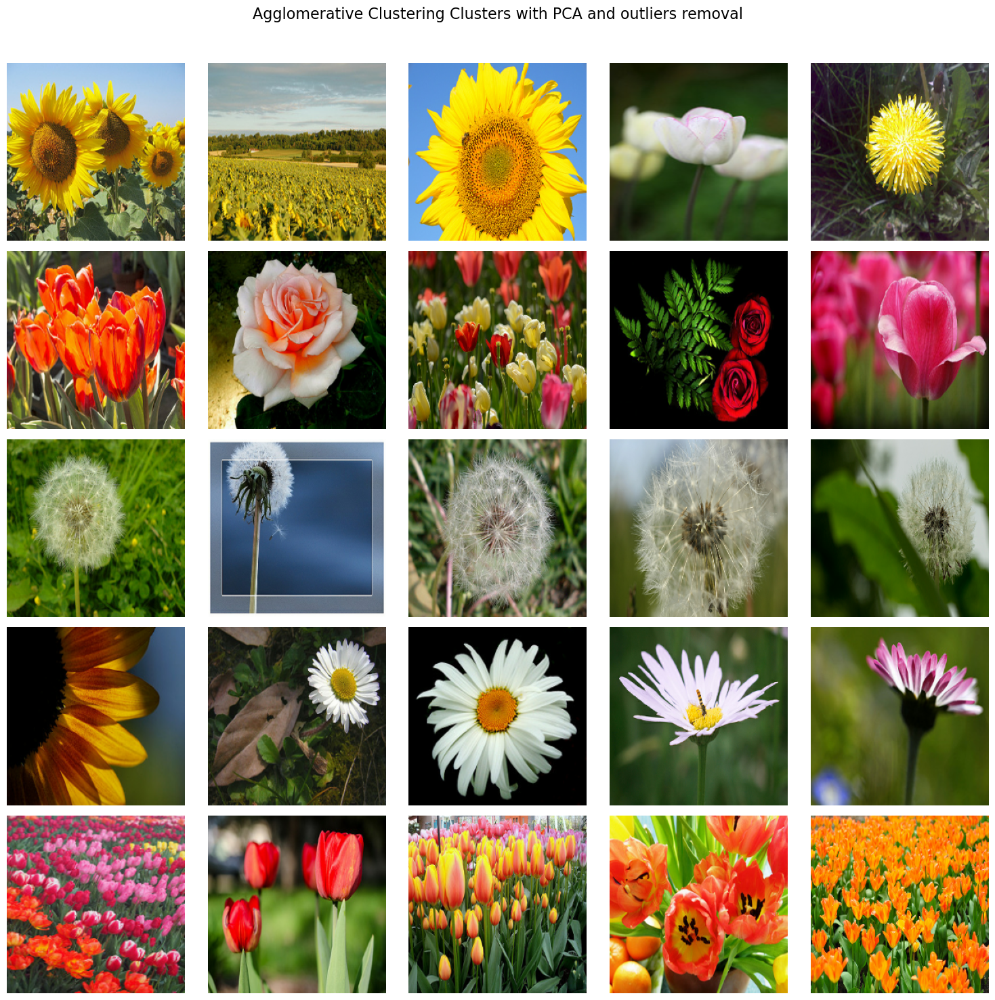

In [10]:
# Outlier detection using z-score
z_scores = np.abs(zscore(reduced_features, axis=0))
threshold = 3.5  # Define a threshold for z-scores
non_outlier_indices = np.where(np.all(z_scores < threshold, axis=1))[0]

# Filter out outliers
reduced_features_cleaned = reduced_features[non_outlier_indices]
images_cleaned = images[non_outlier_indices]

# Clustering with K-Means
kmeans = KMeans(n_clusters=5, random_state=12)
kmeans_clusters = kmeans.fit_predict(reduced_features_cleaned)

# Clustering with Spectral Clustering
spectral = SpectralClustering(n_clusters=5, affinity='nearest_neighbors', random_state=12)
spectral_clusters = spectral.fit_predict(reduced_features_cleaned)

# Clustering with Agglomerative Clustering
agg_clustering = AgglomerativeClustering(n_clusters=5)
agg_clusters = agg_clustering.fit_predict(reduced_features_cleaned)

# Calculate silhouette scores
kmeans_silhouette = silhouette_score(reduced_features_cleaned, kmeans_clusters)
spectral_silhouette = silhouette_score(reduced_features_cleaned, spectral_clusters)
agg_silhouette = silhouette_score(reduced_features_cleaned, agg_clusters)

print(f"Silhouette Score for K-Means: {kmeans_silhouette}")
print(f"Silhouette Score for Spectral Clustering: {spectral_silhouette}")
print(f"Silhouette Score for Agglomerative Clustering: {agg_silhouette}")

# Calculate Calinski-Harabasz scores
kmeans_ch_score = calinski_harabasz_score(reduced_features_cleaned, kmeans_clusters)
spectral_ch_score = calinski_harabasz_score(reduced_features_cleaned, spectral_clusters)
agg_ch_score = calinski_harabasz_score(reduced_features_cleaned, agg_clusters)

# Print Calinski-Harabasz scores
print(f"Calinski-Harabasz Index for K-Means: {kmeans_ch_score}")
print(f"Calinski-Harabasz Index for Spectral Clustering: {spectral_ch_score}")
print(f"Calinski-Harabasz Index for Agglomerative Clustering: {agg_ch_score}")

# Plot random images from K-Means clusters
plot_clusters(images_cleaned, kmeans_clusters, n_clusters=5, title="K-Means Clusters with PCA and outliers removal", seed=99)

# Plot random images from Spectral Clustering clusters
plot_clusters(images_cleaned, spectral_clusters, n_clusters=5, title="Spectral Clustering Clusters with PCA and outliers removal", seed=99)

# Plot random images from Agglomerative Clustering clusters
plot_clusters(images_cleaned, agg_clusters, n_clusters=5, title="Agglomerative Clustering Clusters with PCA and outliers removal", seed=99)


# Custom written algorithms

### Custom Kmeans from scratch

Silhouette Score for custom K-Means: 0.07176411151885986
Calinski-Harabasz Index for custom K-Means: 120.1657378504824


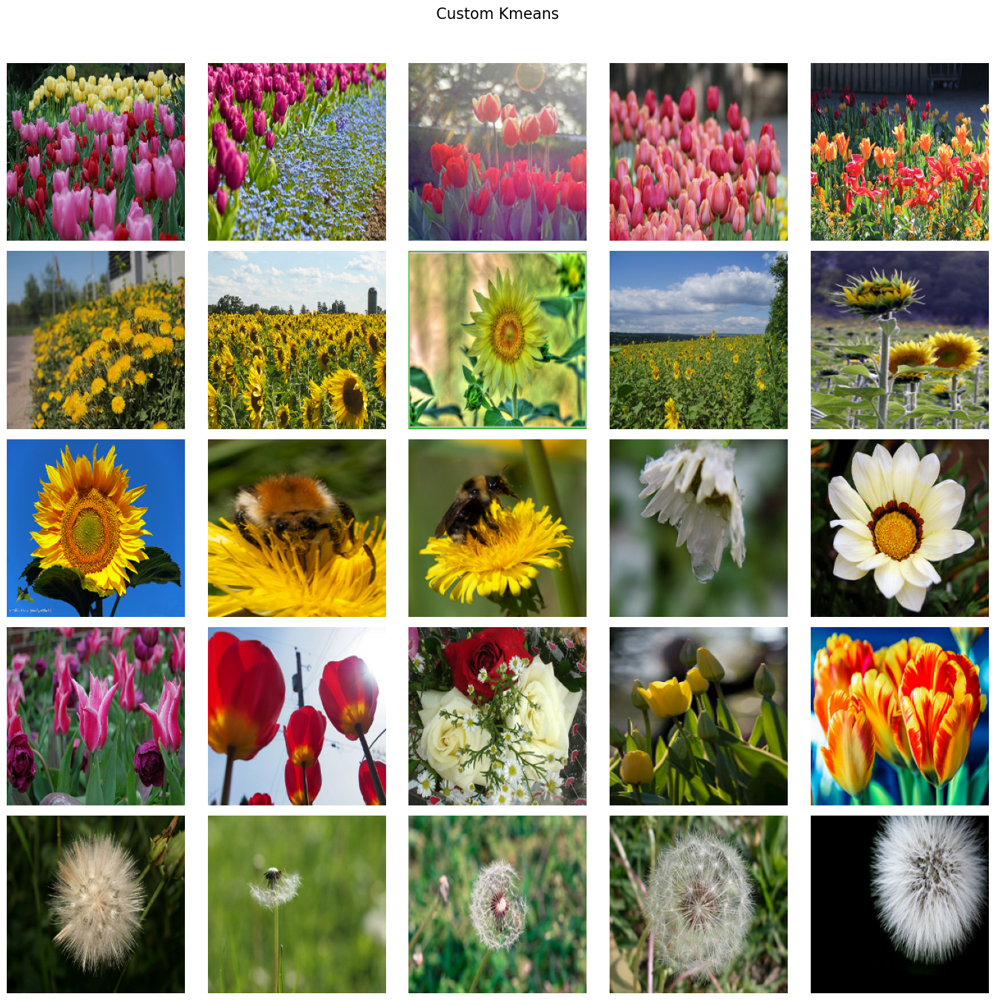

In [13]:
def calculate_euclidean_distance(point_a, point_b):
    """
    Calculate the Euclidean distance
    """
    return np.sqrt(np.sum((point_a - point_b) ** 2))

class custom_Kmeans:
    """
    K-Means
    """
    def __init__(self, num_clusters=5, max_iterations=1000, tolerance=1e-6, random_state=12):
        self.num_clusters = num_clusters
        self.max_iterations = max_iterations
        self.tolerance = tolerance
        self.random_state = random_state

    def _initialize_centroids(self, data):
        """
         selects initial centroids randomly from the dataset.
        """
        if self.random_state is not None:
            np.random.seed(self.random_state)  # Set the seed for reproducibility
        num_samples = data.shape[0]
        centroid_indices = np.random.choice(num_samples, self.num_clusters, replace=False)
        return data[centroid_indices]

    def _assign_data_to_clusters(self, data, centroids):
        """
        assigns each data point to the nearest centroid.
        """
        clusters = [[] for _ in range(self.num_clusters)]
        labels = np.empty(data.shape[0])

        for i, data_point in enumerate(data):
            closest_centroid_index = np.argmin([calculate_euclidean_distance(data_point, centroid) for centroid in centroids])
            clusters[closest_centroid_index].append(i)
            labels[i] = closest_centroid_index

        return clusters, labels

    def _update_centroids(self, data, clusters):
        """
        Updates the centroids


        """
        new_centroids = np.empty((self.num_clusters, data.shape[1]))

        for i, cluster in enumerate(clusters):
            new_centroids[i] = np.mean(data[cluster], axis=0)

        return new_centroids

    def _check_convergence(self, old_centroids, new_centroids):
        """
        Checks if the centroids converged.
        """
        distances = [calculate_euclidean_distance(old_centroid, new_centroid) for old_centroid, new_centroid in zip(old_centroids, new_centroids)]
        return sum(distances) < self.tolerance

    def fit_predict(self, data):
        """
        Trains the custom  K-MEANS
        """
        centroids = self._initialize_centroids(data)

        for _ in range(self.max_iterations):
            clusters, labels = self._assign_data_to_clusters(data, centroids)
            new_centroids = self._update_centroids(data, clusters)

            if self._check_convergence(centroids, new_centroids):
                break

            centroids = new_centroids

        return labels

model = custom_Kmeans(num_clusters=5, random_state=12)
Km_labels = model.fit_predict(reduced_features_cleaned)
kmeans_silhouette = silhouette_score(reduced_features_cleaned, Km_labels)
print(f"Silhouette Score for custom K-Means: {kmeans_silhouette}")

# Calculate Calinski-Harabasz scores
kmeans_ch_score = calinski_harabasz_score(reduced_features_cleaned, Km_labels)
print(f"Calinski-Harabasz Index for custom K-Means: {kmeans_ch_score}")

plot_clusters(images_cleaned, Km_labels, n_clusters=5, title="Custom Kmeans", seed=99)

### Custom spectral clustering from scratch

Silhouette Score for Custom spectral clustering: 0.041287582367658615
Calinski-Harabasz Index for custom spectral clustering: 117.53195691755715


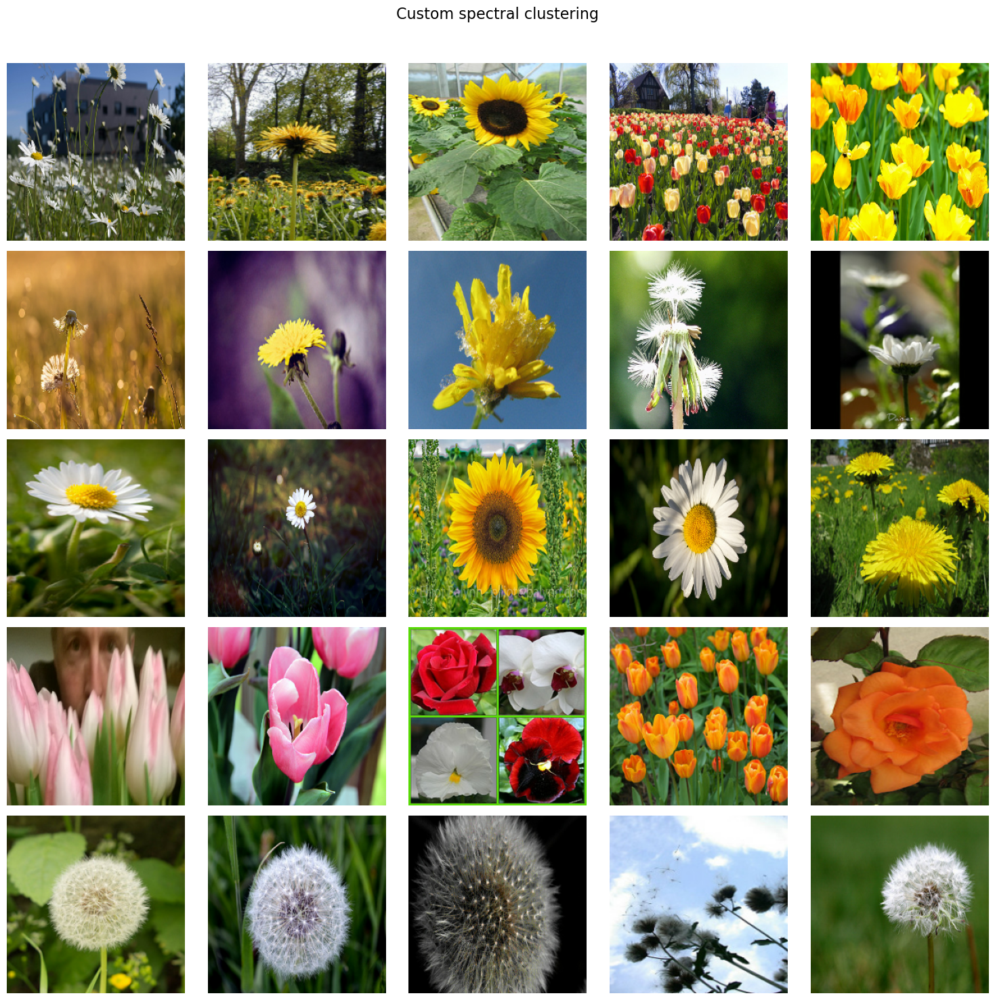

In [15]:

def gaussian_kernel(data_points, bandwidth):
    """
    Calculates the Gaussian kernel similarity matrix.
    """
    num_points = data_points.shape[0]
    similarity_matrix = np.zeros((num_points, num_points))
    for i in range(num_points):
        for j in range(num_points):
            # (the inverse of (2 * bandwidth ** 2)) defaults to 1 / n_features in scikit-learn
            similarity_matrix[i, j] = np.exp(-np.linalg.norm(data_points[i] - data_points[j]) ** 2 / (2 * bandwidth ** 2))
    return similarity_matrix

def normalized_laplacian_matrix(similarity_matrix):
    """
    Calculates the normalized Laplacian matrix.
    """
    degree_matrix = np.diag(np.sum(similarity_matrix, axis=1))
    degree_matrix_inv_sqrt = np.linalg.inv(np.sqrt(degree_matrix))
    laplacian_matrix = np.eye(similarity_matrix.shape[0]) - degree_matrix_inv_sqrt @ similarity_matrix @ degree_matrix_inv_sqrt
    return laplacian_matrix

def compute_eigenvectors_for_clustering(laplacian_matrix, num_clusters):
    """
    Computes the eigenvectors corresponding to the smallest eigenvalues of the Laplacian matrix.
    """
    eigenvalues, eigenvectors = eigh(laplacian_matrix)
    #Find the eigenvectors corresponding to the smallest eigenvalues
    #Indices of the smallest 5 eigenvalues.
    indices = np.argsort(eigenvalues)[:num_clusters]
    return eigenvectors[:, indices]

def cluster_data_with_custom_kmeans(data, num_clusters):
    """
    Performs custom K-Means .
    """
    return custom_Kmeans(num_clusters=num_clusters).fit_predict(data)

def spectral_clustering(data, num_clusters, bandwidth):
    """
    Performs spectral clustering .
    """

    similarity_matrix = gaussian_kernel(data, bandwidth)
    laplacian_matrix = normalized_laplacian_matrix(similarity_matrix)
    eigenvectors = compute_eigenvectors_for_clustering(laplacian_matrix, num_clusters)
    labels = cluster_data_with_custom_kmeans(eigenvectors, num_clusters)
    return labels

SC_labels = spectral_clustering(reduced_features_cleaned, 5, 27)
SC_silhouette = silhouette_score(reduced_features_cleaned, SC_labels)
print(f"Silhouette Score for Custom spectral clustering: {SC_silhouette}")
# Calculate Calinski-Harabasz scores
SC_ch_score = calinski_harabasz_score(reduced_features_cleaned, SC_labels)
# Print Calinski-Harabasz scores
print(f"Calinski-Harabasz Index for custom spectral clustering: {SC_ch_score}")
plot_clusters(images_cleaned, SC_labels, n_clusters=5, title="Custom spectral clustering", seed=99)

### Custom Kmedoids from scratch

Silhouette Score for custom K-Medoids: 0.016870595514774323
Calinski-Harabasz Index for custom K-Medoids: 94.43967137224966


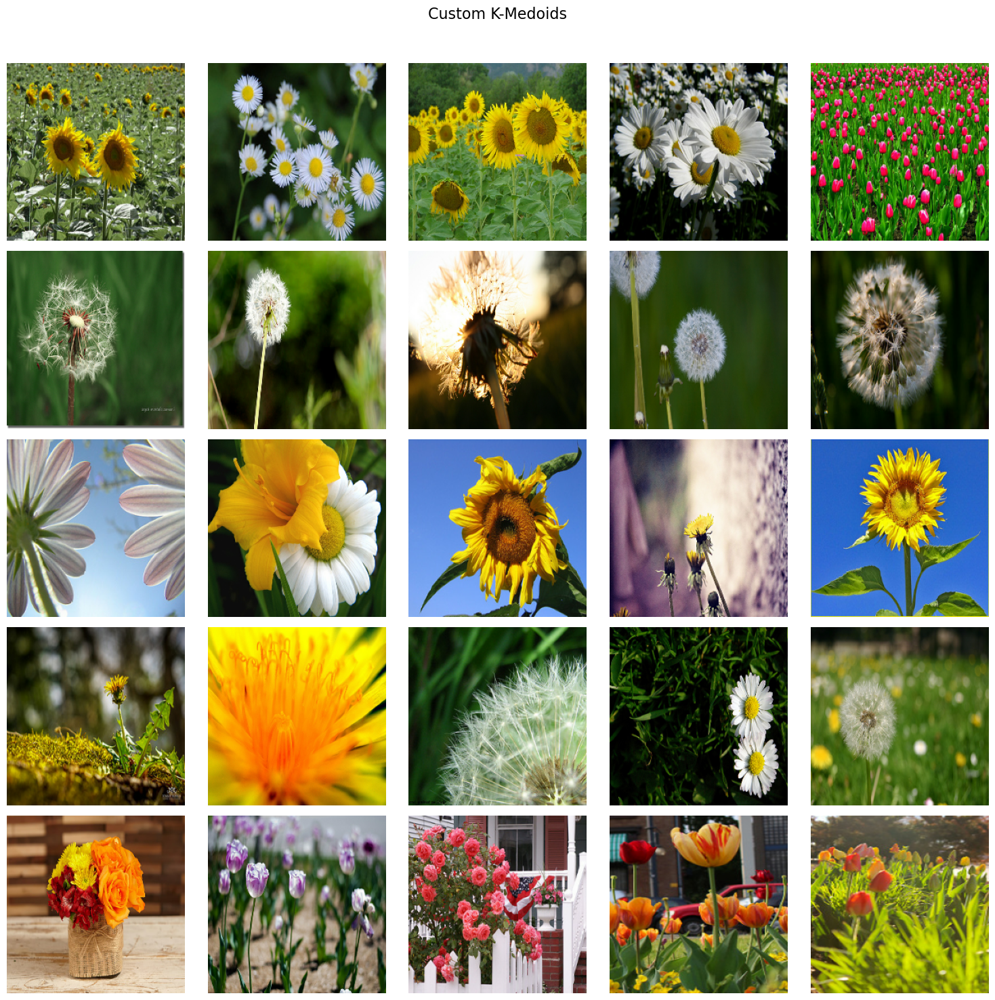

In [33]:
class custom_Kmedoids:
    """
    K-Medoids.
    """
    def __init__(self, num_clusters=5, max_iterations=1000, random_state=88):
        self.num_clusters = num_clusters
        self.max_iterations = max_iterations

        self.random_state = random_state

    def _initialize_medoids(self, data):
        """
        selects initial medoids randomly from the data.
        """
        if self.random_state is not None:
            np.random.seed(self.random_state)
        num_samples = data.shape[0]
        medoid_indices = np.random.choice(num_samples, self.num_clusters, replace=False)
        return medoid_indices

    def _assign_data_to_medoids(self, data, medoids):
        """
        assigns each data point,to the nearest medoid.
        """
        clusters = [[] for _ in range(self.num_clusters)]
        labels = np.empty(data.shape[0])

        for i, data_point in enumerate(data):
            closest_medoid_index = np.argmin([calculate_euclidean_distance(data_point, data[medoid]) for medoid in medoids])
            clusters[closest_medoid_index].append(i)
            labels[i] = closest_medoid_index

        return clusters, labels

    def _update_medoids(self, data, clusters):
        """
        Updates medoids by finding the point in each cluster that minimizes the total distance to other poınts.
        """
        new_medoids = []

        for cluster in clusters:
            intra_distances = [
                sum(calculate_euclidean_distance(data[point], data[other]) for other in cluster)
                for point in cluster
            ]
            new_medoids.append(cluster[np.argmin(intra_distances)])

        return np.array(new_medoids)

    def _check_convergence(self, old_medoids, new_medoids):
        """Checks if the medoids  converged.
        """
        return np.array_equal(old_medoids, new_medoids)

    def fit_predict(self, data):
        """
        Trains the  model

        """
        medoids = self._initialize_medoids(data)

        for _ in range(self.max_iterations):
            clusters, labels = self._assign_data_to_medoids(data, medoids)
            new_medoids = self._update_medoids(data, clusters)
            if self._check_convergence(medoids, new_medoids):
                break
            medoids = new_medoids
        return labels

model = custom_Kmedoids(num_clusters=5, random_state=9)
Kmedoids_labels = model.fit_predict(reduced_features_cleaned)
kmedoids_silhouette = silhouette_score(reduced_features_cleaned, Kmedoids_labels)
print(f"Silhouette Score for custom K-Medoids: {kmedoids_silhouette}")

# Calculate Calinski-Harabasz scores
kmedoids_ch_score = calinski_harabasz_score(reduced_features_cleaned, Kmedoids_labels)
print(f"Calinski-Harabasz Index for custom K-Medoids: {kmedoids_ch_score}")

plot_clusters(images_cleaned, Kmedoids_labels, n_clusters=5, title="Custom K-Medoids", seed=3)
